In [19]:
import numpy as np
import os
import pandas as pd
from corm import model
from projection_fxns import *
from scipy.spatial import Delaunay
from time import time
from scipy.spatial import ConvexHull
%matplotlib inline
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

In [2]:
os.chdir('/Users/Erin/git/COX2/results')

In [3]:
mcmc_samples = pd.DataFrame(np.load('2015_02_02_COX2_all_traces.npy'), columns=['kcat_AA2', 'kcat_AA3', 'KD_AG_cat3', 'KD_AG_cat2', 'KD_AG_allo2', 'KD_AG_allo1', 'KD_AA_allo1', 'KD_AA_allo2', 'KD_AA_allo3', 'kcat_AG3', 'KD_AA_cat3', 'KD_AA_cat2'])

In [4]:
unique_samples = mcmc_samples.drop_duplicates()

In [5]:
norm_shape_idxs = find_shape_idx_for_all_axis_combinations(unique_samples, unique_samples.columns, approx=False)

Testing  220  possible axis combinations.


/Users/Erin/git/moo_and_mcmc/ensemble_analysis/projection_fxns.py:30: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  points = [all_points[idx] for idx in indices]


Tested  0  of  220  combinations.
Tested  10  of  220  combinations.
Tested  20  of  220  combinations.
Tested  30  of  220  combinations.
Tested  40  of  220  combinations.
Tested  50  of  220  combinations.
Tested  60  of  220  combinations.
Tested  70  of  220  combinations.
Tested  80  of  220  combinations.
Tested  90  of  220  combinations.
Tested  100  of  220  combinations.
Tested  110  of  220  combinations.
Tested  120  of  220  combinations.
Tested  130  of  220  combinations.
Tested  140  of  220  combinations.
Tested  150  of  220  combinations.
Tested  160  of  220  combinations.
Tested  170  of  220  combinations.
Tested  180  of  220  combinations.
Tested  190  of  220  combinations.
Tested  200  of  220  combinations.
Tested  210  of  220  combinations.


In [6]:
norm_shapes_approx = find_shape_idx_for_all_axis_combinations(unique_samples, unique_samples.columns, approx=True)

Testing  220  possible axis combinations.
Tested  0  of  220  combinations.
Tested  10  of  220  combinations.
Tested  20  of  220  combinations.
Tested  30  of  220  combinations.
Tested  40  of  220  combinations.
Tested  50  of  220  combinations.
Tested  60  of  220  combinations.
Tested  70  of  220  combinations.
Tested  80  of  220  combinations.
Tested  90  of  220  combinations.
Tested  100  of  220  combinations.
Tested  110  of  220  combinations.
Tested  120  of  220  combinations.
Tested  130  of  220  combinations.
Tested  140  of  220  combinations.
Tested  150  of  220  combinations.
Tested  160  of  220  combinations.
Tested  170  of  220  combinations.
Tested  180  of  220  combinations.
Tested  190  of  220  combinations.
Tested  200  of  220  combinations.
Tested  210  of  220  combinations.


In [23]:
test = find_shape_idx_for_all_axis_combinations(unique_samples, unique_samples.columns, approx=True)

Testing  220  possible axis combinations.
Tested  0  of  220  combinations.
Tested  10  of  220  combinations.
Tested  20  of  220  combinations.
Tested  30  of  220  combinations.
Tested  40  of  220  combinations.
Tested  50  of  220  combinations.
Tested  60  of  220  combinations.
Tested  70  of  220  combinations.
Tested  80  of  220  combinations.
Tested  90  of  220  combinations.
Tested  100  of  220  combinations.
Tested  110  of  220  combinations.
Tested  120  of  220  combinations.
Tested  130  of  220  combinations.
Tested  140  of  220  combinations.
Tested  150  of  220  combinations.
Tested  160  of  220  combinations.
Tested  170  of  220  combinations.
Tested  180  of  220  combinations.
Tested  190  of  220  combinations.
Tested  200  of  220  combinations.
Tested  210  of  220  combinations.


In [7]:
for n, idx in enumerate(norm_shape_idxs.index):
    print norm_shape_idxs.iloc[n], norm_shapes_approx.iloc[n], idx, norm_shapes_approx.index[n]

norm shape index    0.442544
Name: (kcat_AA2, kcat_AA3, KD_AG_cat3), dtype: object norm shape index    1.65658
Name: (kcat_AA2, kcat_AA3, KD_AG_cat3), dtype: object ('kcat_AA2', 'kcat_AA3', 'KD_AG_cat3') ('kcat_AA2', 'kcat_AA3', 'KD_AG_cat3')
norm shape index    0.483057
Name: (kcat_AA2, kcat_AA3, KD_AG_cat2), dtype: object norm shape index    1.65669
Name: (kcat_AA2, kcat_AA3, KD_AG_cat2), dtype: object ('kcat_AA2', 'kcat_AA3', 'KD_AG_cat2') ('kcat_AA2', 'kcat_AA3', 'KD_AG_cat2')
norm shape index    1.10844
Name: (kcat_AA2, kcat_AA3, KD_AG_allo2), dtype: object norm shape index    1.38667
Name: (kcat_AA2, kcat_AA3, KD_AG_allo2), dtype: object ('kcat_AA2', 'kcat_AA3', 'KD_AG_allo2') ('kcat_AA2', 'kcat_AA3', 'KD_AG_allo2')
norm shape index    0.467059
Name: (kcat_AA2, kcat_AA3, KD_AG_allo1), dtype: object norm shape index    1.65721
Name: (kcat_AA2, kcat_AA3, KD_AG_allo1), dtype: object ('kcat_AA2', 'kcat_AA3', 'KD_AG_allo1') ('kcat_AA2', 'kcat_AA3', 'KD_AG_allo1')
norm shape index    0

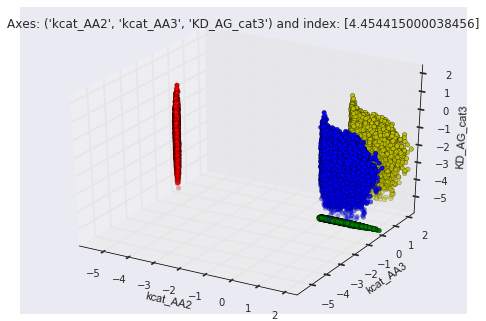

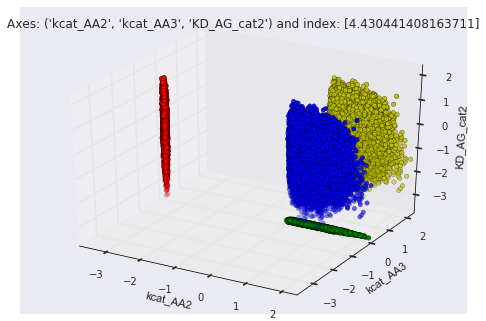

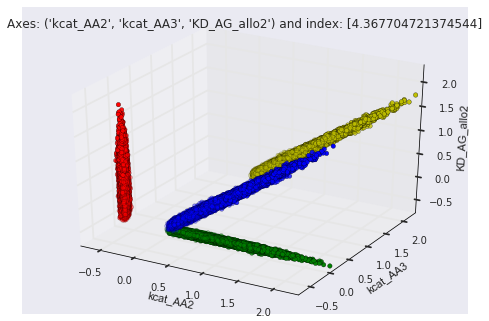

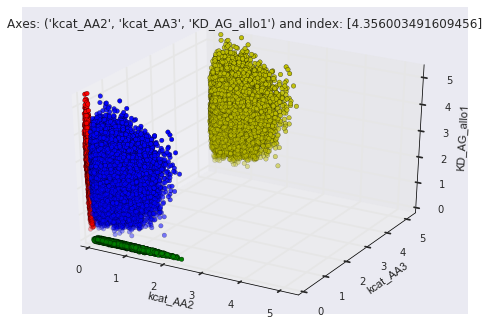

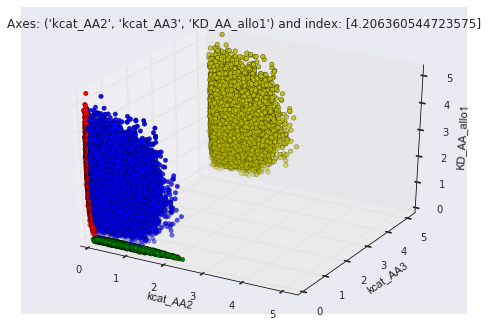

...

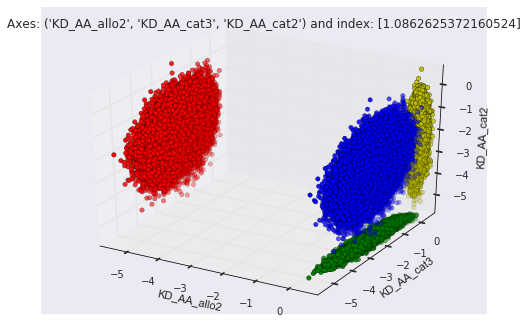

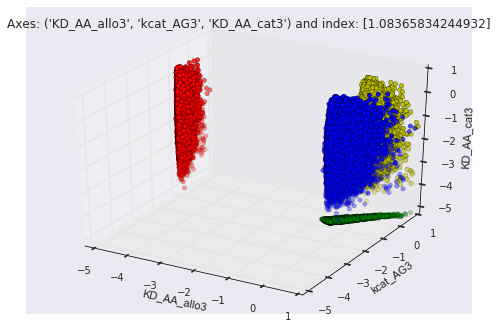

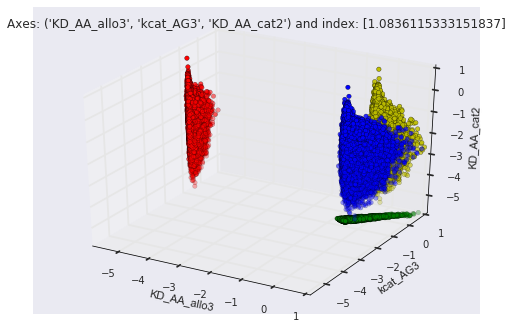

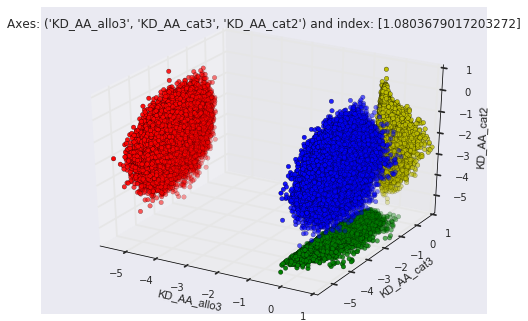

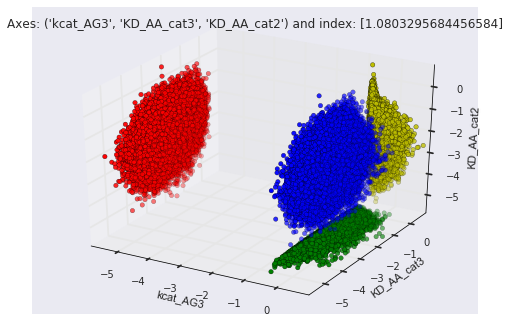

In [83]:
for i, combo in enumerate(norm_shape_idxs.index):
    proj_min = np.min(np.concatenate((unique_samples[combo[0]].values, unique_samples[combo[1]].values, unique_samples[combo[2]].values)))
    proj_max = np.max(np.concatenate((unique_samples[combo[0]].values, unique_samples[combo[1]].values, unique_samples[combo[2]].values)))
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(unique_samples[combo[0]], unique_samples[combo[1]], c='g', zdir='z', zs=proj_min)
    ax.scatter(unique_samples[combo[1]], unique_samples[combo[2]], c='r', zdir='x', zs=proj_min)
    ax.scatter(unique_samples[combo[0]], unique_samples[combo[2]], c='y', zdir='y', zs=proj_max)
    ax.scatter(unique_samples[combo[0]], unique_samples[combo[1]], unique_samples[combo[2]])
    ax.set_title('Axes: '+str(combo)+' and index: '+str(norm_shapes_approx.iloc[i].values))
    ax.set_xlim((proj_min, proj_max))
    ax.set_ylim((proj_min, proj_max))
    ax.set_zlim((proj_min, proj_max))
    ax.set_xlabel(str(combo[0]))
    ax.set_ylabel(str(combo[1]))
    ax.set_zlabel(str(combo[2]))

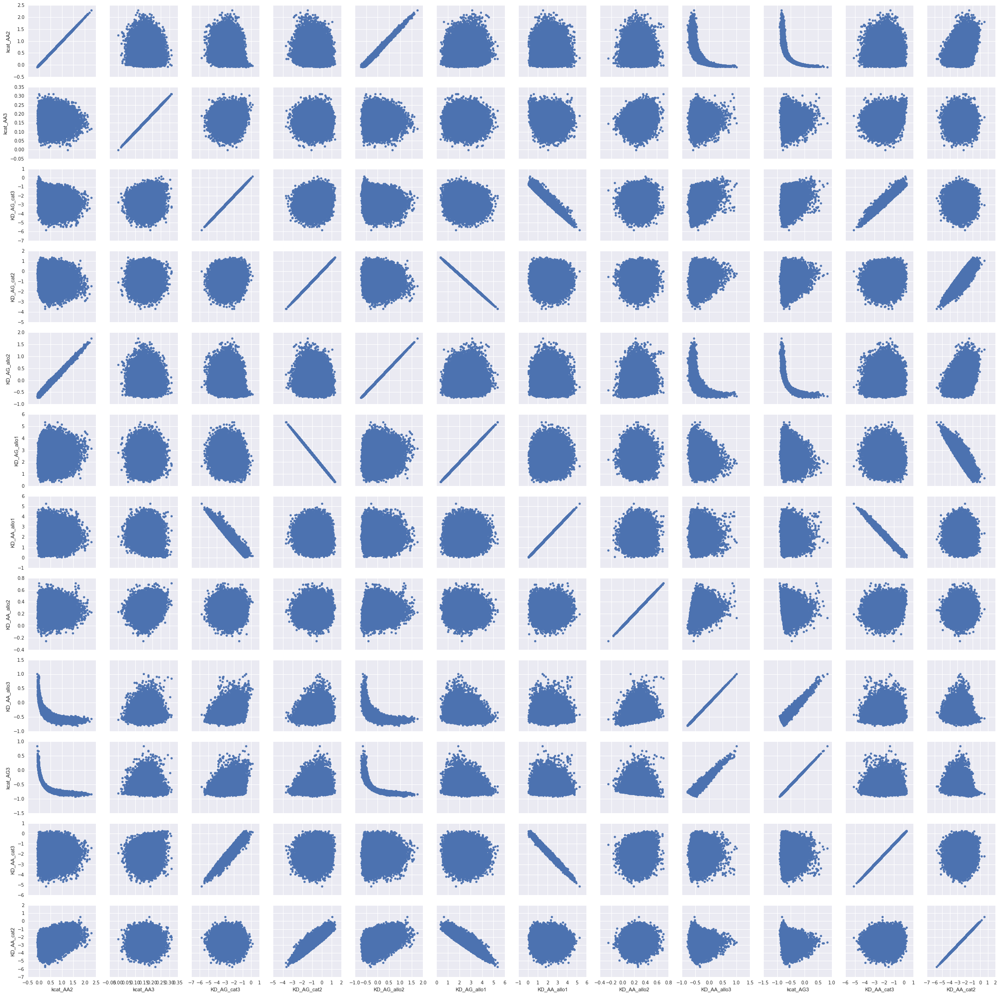

In [21]:
g = sns.PairGrid(unique_samples)
g.map(plt.scatter)

In [16]:
norm_shapes_approx.sort_values(by='norm shape index', inplace=True, ascending=False)

In [76]:
norm_shapes_approx.index[9]

('KD_AA_allo1', 'KD_AA_allo2', 'KD_AA_cat3')

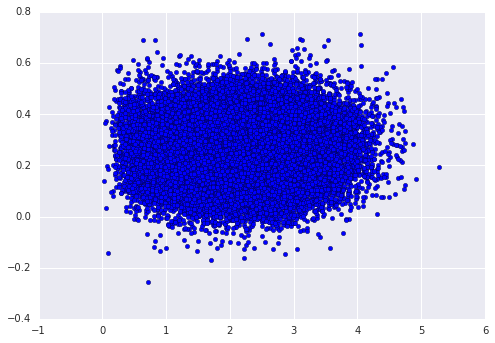

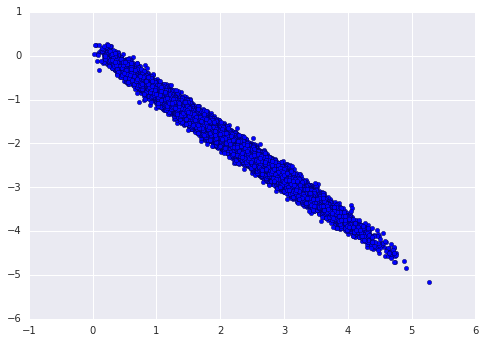

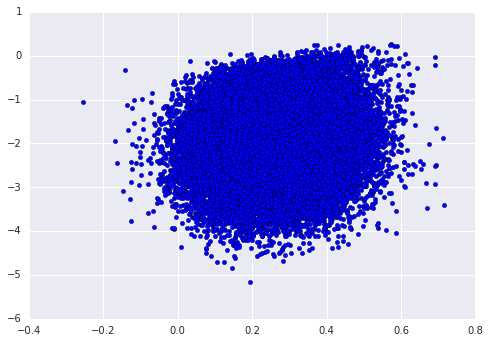

In [77]:
plt.figure()
plt.scatter(unique_samples['KD_AA_allo1'], unique_samples['KD_AA_allo2'])
plt.figure()
plt.scatter(unique_samples['KD_AA_allo1'], unique_samples['KD_AA_cat3'])
plt.figure()
plt.scatter(unique_samples['KD_AA_allo2'], unique_samples['KD_AA_cat3'])

In [17]:
norm_shapes_approx

,norm shape index
"(KD_AG_cat3, KD_AG_cat2, KD_AG_allo1)",4.45442
"(KD_AG_cat2, KD_AG_allo1, KD_AA_cat3)",4.43044
"(KD_AG_cat2, KD_AG_allo1, KD_AA_allo1)",4.3677
"(KD_AG_allo2, KD_AG_allo1, KD_AA_cat2)",4.356
"(KD_AG_cat3, KD_AA_allo1, KD_AA_allo3)",4.20636
"(KD_AG_cat2, KD_AG_allo1, KD_AA_cat2)",4.01304
"(KD_AG_cat2, KD_AG_allo2, KD_AG_allo1)",4.01089
"(kcat_AA2, KD_AG_cat2, KD_AG_allo1)",3.97225
"(KD_AG_cat2, KD_AG_allo2, KD_AA_cat2)",3.89569
"(KD_AA_allo1, KD_AA_allo2, KD_AA_cat3)",3.77428


In [5]:
test_projection = np.squeeze(np.dstack((unique_samples['kcat_AA2'].values, unique_samples['kcat_AG3'].values, unique_samples['KD_AA_allo1'])))

In [6]:
start = time()
idx = calc_normalized_shape_idx(test_projection)
end = time()
print 'Finished in: ',end-start,' seconds.'

Finished in:  0.015153169632  seconds.


In [7]:
idx

1.5531127603376766

In [18]:
hull.area

27.93392862541017

In [19]:
hull.volume

6.478540077546904

In [23]:
pt_range = np.ptp(test_projection, axis=0)
possible_vol = pt_range[0]*pt_range[1]*pt_range[2]
frac_filled = hull.volume/possible_vol
np.sqrt(hull.area)/(hull.volume**(1/3))*frac_filled

1.5531127603376766

In [15]:
calc_total_volume_in_trimmed_hull(tri.simplices, test_projection)

6.4785400775469943

In [13]:
kept_simplices, simplices_to_remove = find_hull_simplices_to_remove(test_projection)

In [14]:
tri = Delaunay(test_projection)
pruned_simplices, pruned_boundaries, new_surface_tri = prune_simplices_from_triangulation(tri, simplices_to_remove)

In [8]:
len(pruned_boundaries)

150

In [9]:
pruned_simplices[0]

array([11629, 32247,  4251, 32248], dtype=int32)

In [8]:
start = time()
volume = calc_total_volume_in_trimmed_hull(pruned_simplices, test_projection)
end = time()
print 'Finished in : ',end-start,' seconds.'

Finished in :  5.81733417511  seconds.


In [9]:
volume

6.2266287216828129

In [9]:
start = time()
area = hull_surface_area(kept_simplices, new_surface_tri, test_projection)
end = time()
print 'Finished in: ',end-start,' seconds.'

Finished in:  0.00385499000549  seconds.


/Users/Erin/git/moo_and_mcmc/ensemble_analysis/projection_fxns.py:28: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  points = [all_points[idx] for idx in indices]


In [11]:
area

25.974935252909646

In [11]:
calc_normalized_shape_idx(area, volume, test_projection)

1.4394282969329122

In [14]:
np.ptp(test_projection, axis=0)

array([ 2.38513076,  1.75987669,  5.25225422])

In [20]:
6.47/(2.38*1.75*5.25)

0.29588978448522263

In [17]:
boundary_mask = np.any(np.apply_along_axis(np.in1d, 1, tri.neighbors, -1), axis=1)
boundary_simplices = tri.simplices[boundary_mask]
pruning_mask = np.ones(len(tri.simplices), dtype='bool')
final_boundary_mask = boundary_mask

In [27]:
idx = np.where(np.all(np.apply_along_axis(np.in1d, 1, simplices_to_remove, boundary_simplices[0]), axis=1))

In [35]:
pruning_mask[boundary_mask] = False
test = np.invert(boundary_mask)

In [54]:
final_boundary_mask = np.ones(len(boundary_simplices), dtype='bool')

In [58]:
pruning_mask[boundary_mask] = final_boundary_mask

In [59]:
pruning_mask

array([ True,  True,  True, ...,  True,  True,  True], dtype=bool)

In [19]:
pruning_mask[boundary_mask][pruned_simplice_idx] = False
if pruned_simplice_idx:
    final_boundary_mask[pruned_simplice_idx] = False

163